In [1]:
from IPython.display import Image
from IPython.core.display import HTML
Image(url= "https://developer.spotify.com/assets/echonest-spotify.png")

In [2]:
# Need only first time
#conda install -c conda-forge python-dotenv
#conda install -c conda-forge pydot

In [3]:
%matplotlib inline
import IPython.display as ipd
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import datetime
import plotly
import plotly.express as px
import plotly.io as pio
import plotly.offline as pyo
import seaborn as sns

#import sys
#import pathlib
#sys.path.insert(1, '/Users/samuele/University/2.DM2/DataMining-2/fma_metadata/')
#from fma_metadata import utils
import utils

import warnings
warnings.filterwarnings('ignore')

-----------------
# Tracks EDA
-----------------
## 1. Load Dataset
tracks.csv: contains metadata about tracks, albums and artists;
This dataset contains the following subsets:
- track, informations about the track by itself (duration, genre, composer, tags, bit_rate, etc.)
- album, informations about the album containg the track
- artist, Informations about the artist that wrote the song
- set, contains split and subset; the first contains if the track contains to the validation, training or test set, the second whether it contains to the small, medium or large dataset

In [4]:
# Load data
tracks = utils.load('../../../fma_metadata/Dataset/tracks.csv')
tracks.shape

(106574, 52)

In [5]:
print(tracks['set'].split.unique())
print(tracks['set'].subset.unique())

['training' 'validation' 'test']
['small' 'medium' 'large']


In [6]:
album = tracks['album'][['tracks', 'id']]
album = album.rename(columns = {"tracks": "album_tracks", "id": "album_id"})
album

,album_tracks,album_id
track_id,,
2,7,1
3,7,1
5,7,1
10,2,6
20,13,4
...,...,...
155316,6,22940
155317,6,22940
155318,6,22940


In [7]:
artist = tracks['artist'][['id', 'location']]
artist = artist.rename(columns = {"id": "artist_id", "location": "artist_location"})
artist

,artist_id,artist_location
track_id,,
2,1,New Jersey
3,1,New Jersey
5,1,New Jersey
10,6,NaN
20,4,Colchester England
...,...,...
155316,24357,New Jersey
155317,24357,New Jersey
155318,24357,New Jersey


In [8]:
track = tracks['track']
track = track.join(artist, on = 'track_id')
track = track.join(album, on = 'track_id')
track.columns

Index(['bit_rate', 'comments', 'composer', 'date_created', 'date_recorded',
       'duration', 'favorites', 'genre_top', 'genres', 'genres_all',
       'information', 'interest', 'language_code', 'license', 'listens',
       'lyricist', 'number', 'publisher', 'tags', 'title', 'artist_id',
       'artist_location', 'album_tracks', 'album_id'],
      dtype='object')

## 2. Data Understanding
------

In [9]:
#### Data available (%) - tracks.csv - partition: "album"
print('Available data - album subset - Tracks.csv (%)')
print(((abs(tracks['album'].isnull().sum()-tracks.shape[0])/tracks.shape[0])*100).round(2).sort_values(ascending=False))
tracks['album'].head()

Available data - album subset - Tracks.csv (%)
tracks           100.00
tags             100.00
listens          100.00
id               100.00
favorites        100.00
comments         100.00
title             99.04
date_created      96.69
type              93.89
information       78.02
date_released     65.96
producer          16.95
engineer          14.35
dtype: float64


,comments,date_created,date_released,engineer,favorites,id,information,listens,producer,tags,title,tracks,type
track_id,,,,,,,,,,,,,
2,0,2008-11-26 01:44:45,2009-01-05,NaN,4,1,<p></p>,6073,NaN,[],AWOL - A Way Of Life,7,Album
3,0,2008-11-26 01:44:45,2009-01-05,NaN,4,1,<p></p>,6073,NaN,[],AWOL - A Way Of Life,7,Album
5,0,2008-11-26 01:44:45,2009-01-05,NaN,4,1,<p></p>,6073,NaN,[],AWOL - A Way Of Life,7,Album
10,0,2008-11-26 01:45:08,2008-02-06,NaN,4,6,NaN,47632,NaN,[],Constant Hitmaker,2,Album
20,0,2008-11-26 01:45:05,2009-01-06,NaN,2,4,"<p> ""spiritual songs"" from Nicky Cook</p>",2710,NaN,[],Niris,13,Album


In [10]:
#### Data available (%) - tracks.csv - partition: "artist"
print('Available data - artist subset - Tracks.csv (%)')
print(((abs(tracks['artist'].isnull().sum()-tracks.shape[0])/tracks.shape[0])*100).round(2).sort_values(ascending=False))
tracks['artist'].head()

Available data - artist subset - Tracks.csv (%)
comments             100.00
tags                 100.00
name                 100.00
id                   100.00
favorites            100.00
date_created          99.20
website               74.37
bio                   66.77
location              65.88
members               43.96
latitude              41.80
longitude             41.80
active_year_begin     21.31
associated_labels     13.39
related_projects      12.34
wikipedia_page         5.24
active_year_end        5.04
dtype: float64


,active_year_begin,active_year_end,associated_labels,bio,comments,date_created,favorites,id,latitude,location,longitude,members,name,related_projects,tags,website,wikipedia_page
track_id,,,,,,,,,,,,,,,,,
2,2006-01-01,NaT,NaN,"<p>A Way Of Life, A Collective of Hip-Hop from...",0,2008-11-26 01:42:32,9,1,40.058324,New Jersey,-74.405661,"Sajje Morocco,Brownbum,ZawidaGod,Custodian of ...",AWOL,The list of past projects is 2 long but every1...,[awol],http://www.AzillionRecords.blogspot.com,NaN
3,2006-01-01,NaT,NaN,"<p>A Way Of Life, A Collective of Hip-Hop from...",0,2008-11-26 01:42:32,9,1,40.058324,New Jersey,-74.405661,"Sajje Morocco,Brownbum,ZawidaGod,Custodian of ...",AWOL,The list of past projects is 2 long but every1...,[awol],http://www.AzillionRecords.blogspot.com,NaN
5,2006-01-01,NaT,NaN,"<p>A Way Of Life, A Collective of Hip-Hop from...",0,2008-11-26 01:42:32,9,1,40.058324,New Jersey,-74.405661,"Sajje Morocco,Brownbum,ZawidaGod,Custodian of ...",AWOL,The list of past projects is 2 long but every1...,[awol],http://www.AzillionRecords.blogspot.com,NaN
10,NaT,NaT,"Mexican Summer, Richie Records, Woodsist, Skul...","<p><span style=""font-family:Verdana, Geneva, A...",3,2008-11-26 01:42:55,74,6,NaN,NaN,NaN,"Kurt Vile, the Violators",Kurt Vile,NaN,"[philly, kurt vile]",http://kurtvile.com,NaN
20,1990-01-01,2011-01-01,NaN,<p>Songs written by: Nicky Cook</p>\n<p>VOCALS...,2,2008-11-26 01:42:52,10,4,51.895927,Colchester England,0.891874,Nicky Cook\n,Nicky Cook,NaN,"[instrumentals, experimental pop, post punk, e...",NaN,NaN


### Partition: Track
-----

In [11]:
# checks percentage of available data
print('Available data - track subset - Tracks.csv (%)')
print(((abs(tracks['track'].isnull().sum()-tracks.shape[0])/tracks.shape[0])*100).round(2).sort_values(ascending=False))

Available data - track subset - Tracks.csv (%)
title            100.00
interest         100.00
comments         100.00
date_created     100.00
duration         100.00
favorites        100.00
genres           100.00
tags             100.00
genres_all       100.00
listens          100.00
number           100.00
bit_rate         100.00
license           99.92
genre_top         46.54
language_code     14.10
date_recorded      5.78
composer           3.44
information        2.20
publisher          1.19
lyricist           0.29
dtype: float64


In [12]:
print(track.shape)
track.head()

(106574, 24)


,bit_rate,comments,composer,date_created,date_recorded,duration,favorites,genre_top,genres,genres_all,...,listens,lyricist,number,publisher,tags,title,artist_id,artist_location,album_tracks,album_id
track_id,,,,,,,,,,,,,,,,,,,,,
2,256000,0,NaN,2008-11-26 01:48:12,2008-11-26,168,2,Hip-Hop,[21],[21],...,1293,NaN,3,NaN,[],Food,1,New Jersey,7,1
3,256000,0,NaN,2008-11-26 01:48:14,2008-11-26,237,1,Hip-Hop,[21],[21],...,514,NaN,4,NaN,[],Electric Ave,1,New Jersey,7,1
5,256000,0,NaN,2008-11-26 01:48:20,2008-11-26,206,6,Hip-Hop,[21],[21],...,1151,NaN,6,NaN,[],This World,1,New Jersey,7,1
10,192000,0,Kurt Vile,2008-11-25 17:49:06,2008-11-26,161,178,Pop,[10],[10],...,50135,NaN,1,NaN,[],Freeway,6,NaN,2,6
20,256000,0,NaN,2008-11-26 01:48:56,2008-01-01,311,0,NaN,"[76, 103]","[17, 10, 76, 103]",...,361,NaN,3,NaN,[],Spiritual Level,4,Colchester England,13,4


In [13]:
fig = px.histogram(track['date_recorded'], x="date_recorded")
fig.show()

In [14]:
fig = px.histogram(track['bit_rate'], x="bit_rate")
fig.show()

In [15]:
fig = px.histogram(track['duration'][track['duration'].values < 800], x="duration")
fig.show()

<AxesSubplot:>

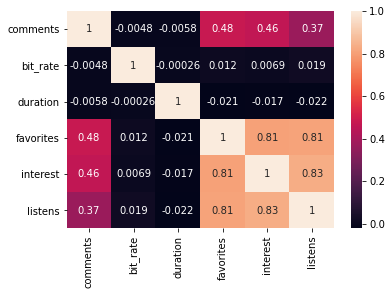

In [16]:
corr = track[['comments', 'bit_rate', 'duration', 'favorites', 'interest', 'listens']].corr()
sns.heatmap(corr, annot = True)

<AxesSubplot:xlabel='favorites'>

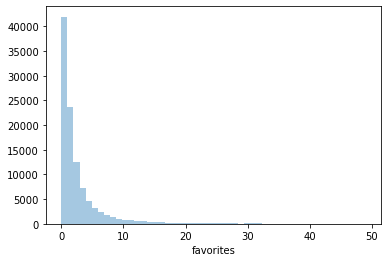

In [40]:
sns.distplot(track['favorites'][track['favorites'] < 50], kde = False)

<AxesSubplot:xlabel='interest'>

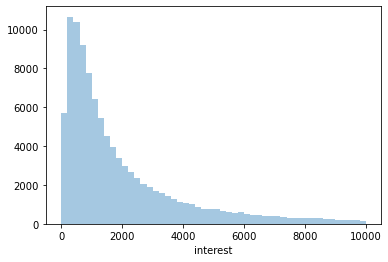

In [36]:
sns.distplot(track['interest'][track['interest'] < 10000], kde = False)

<AxesSubplot:xlabel='listens'>

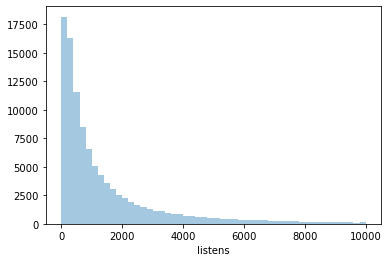

In [38]:
sns.distplot(track['listens'][track['listens'] < 10000], kde = False)

In [17]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(go.Scatter(y=track['comments'], name="Comments", fillcolor='rgba(239, 85, 59)', opacity=1), secondary_y=False,)
fig.add_trace(go.Scatter(y=track['listens'], name="Listens", fillcolor='rgba(99, 110, 250)', opacity=0.8), secondary_y=True,)
fig.update_layout(title_text="Correlation between Comments and Listens on tracks")
fig.update_xaxes(title_text="Track IDs")
fig.update_yaxes(title_text="Comments", secondary_y=False)
fig.update_yaxes(title_text="Listens", secondary_y=True)
fig.show()

print('Correlation between listen and comments into a song: ', track['comments'].corr(track['listens']))

Correlation between listen and comments into a song:  0.37212281361044575


In [18]:
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(go.Scatter(y=track['interest'], name="Interest", fillcolor='rgba(239, 85, 59)', opacity=1), secondary_y=False)
fig.add_trace(go.Scatter(y=track['listens'], name="Listens", fillcolor='rgba(99, 110, 250)', opacity=0.8), secondary_y=True,)
fig.update_layout(title_text="Correlation between Interest and Listens on tracks")
fig.update_xaxes(title_text="Track IDs")
fig.update_yaxes(title_text="Interest", secondary_y=False)
fig.update_yaxes(title_text="Listens", secondary_y=True)

fig.show()

print('Correlation between listens and intereset into a song: ', track['listens'].corr(track['interest']))

Correlation between listens and intereset into a song:  0.8337297738921108


In [19]:
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(go.Scatter(y=track['interest'], name="Interest", fillcolor='rgba(239, 85, 59)', opacity=1), secondary_y=False)
fig.add_trace(go.Scatter(y=track['favorites'], name="Favorites", fillcolor='rgba(99, 110, 250)', opacity=0.8), secondary_y=True,)
fig.update_layout(title_text="Correlation between Interest and Favorites on tracks")
fig.update_xaxes(title_text="Track IDs")
fig.update_yaxes(title_text="Interest", secondary_y=False)
fig.update_yaxes(title_text="Favorites", secondary_y=True)

fig.show()

print('Correlation between favourites and intereset into a song: ', track['favorites'].corr(track['interest']))

Correlation between favourites and intereset into a song:  0.8081151216941785


In [20]:
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(go.Scatter(y=track['favorites'], name="Favorites", fillcolor='rgba(239, 85, 59)', opacity=1), secondary_y=False)
fig.add_trace(go.Scatter(y=track['listens'], name="Listens", fillcolor='rgba(99, 110, 250)', opacity=0.8), secondary_y=True,)
fig.update_layout(title_text="Correlation between Interest and Listens on tracks")
fig.update_xaxes(title_text="Track IDs")
fig.update_yaxes(title_text="Favorites", secondary_y=False)
fig.update_yaxes(title_text="Listens", secondary_y=True)

fig.show()

print('Correlation between listens and favorites into a song: ', track['listens'].corr(track['favorites']))

Correlation between listens and favorites into a song:  0.8101285531507655
